# Model Training and Saving
This notebook trains the various models that I implement for my project. Some of teh data from the models is then converted to a Plotly figure and saved as a JSON string to be rendered for the front end of my website (found here: https://anna-koretchko.ue.r.appspot.com/strava) Training locally and saving the model is much cheaper than doing it all on the flask/GCP front end. 

**Enjoy the analysis and check out the site for the full walkthrough!**

In [12]:
import os
import secrets
import json
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from datetime import datetime as date
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly.tools import FigureFactory as FF
from sklearn.linear_model import LinearRegression
import dash
import dash_core_components as dcc
import dash_html_components as html
from dash.dependencies import Input, Output
import numpy as np
import plotly.graph_objects as go
import plotly.express as px
from sklearn.model_selection import train_test_split
from sklearn import linear_model, tree, neighbors
from sklearn.svm import SVR
import statsmodels.api as sm

In [13]:
# Reads in the data from the API and historic data into panda dfs

df_strava_combined = pd.read_csv(r'/Users/anna/Google Drive/Projects/strava_analysis/strava_analysis/data/combined_activities.csv')
df_strava_historic = pd.read_csv(r'/Users/anna/Google Drive/Projects/strava_analysis/strava_analysis/data/historic_activities_clean.csv')
df_api = pd.read_csv(r'/Users/anna/Google Drive/Projects/strava_analysis/strava_analysis/data/new_activities_clean.csv')


In [14]:
def compare_time_frames(df):
    
    """[Takes two sets of times periods and compares results of the two time frames]

    Args:
        file_path ([str]): [path to csv]
        start_1 ([type]): [beginning of time_frame_1]
        end_1 ([type]): [end of time_frame_1]
        start_2 ([type]): [beginning of time_frame_2]
        end_2 ([type]): [end of time_frame_2]
    """
    
    
    # Run faster in NC (t1) or SoFlo (t2)?
    start_1 = '2019-07-01'
    end_1 = '2020-04-01'
    start_2 = '2020-10-03'
    end_2 = '2021-04-26'



    #Create new dataframe with only columns I care about
    cols = ['name', 'upload_id', 'type', 'distance', 'moving_time',   
            'average_speed', 'max_speed','total_elevation_gain',
            'activity_date'
        ]
    df = df[cols]


    
    # get only running activities
    run = df.loc[df['type'] == 'Run'] 
 
    # convert time strings
    start_1 = date.strptime(start_1, '%Y-%m-%d').date()
    end_1 = date.strptime(end_1, '%Y-%m-%d').date()
    start_2 = date.strptime(start_2, '%Y-%m-%d').date()
    end_2 = date.strptime(end_2, '%Y-%m-%d').date()

    run['activity_date'] = pd.to_datetime(run['activity_date']).dt.date

    # chunk time frames

    # create column that is T if in t1 and F all else
    run['time_frame_1'] = np.where( (run['activity_date'] > start_1) & (run['activity_date'] < end_1), 'T', 'F')
    # get rows that fall in t1 column 
    time_frame_1 = run.loc[run['time_frame_1'] == 'T']


    
    # create column that is F if in t2 and F all else
    run['time_frame_2'] = np.where( (run['activity_date'] > start_2) & (run['activity_date'] < end_2), 'T', 'F')
    # get rows that fall in t2 column
    time_frame_2 = run.loc[run['time_frame_2'] == 'T']

    # get speed for each time period and also converts (time is in seconds, distance is in meters.
    #  m/s to mph 1 m/s to 2.237 mph)
    t1_speed = round(time_frame_1['average_speed'].mean() * 2.237, 2)
    t2_speed = round(time_frame_2['average_speed'].mean() * 2.237, 2)
    t1_max_speed = round(time_frame_1['max_speed'].mean()* 2.237, 2)
    t2_max_speed = round(time_frame_2['max_speed'].mean()* 2.237, 2)

    print("Average T1 Speed: " + str(t1_speed) + " | Average T1 Max Speed: " + str(t1_max_speed) + '\n'
        + "Average T2 Speed: " + str(t2_speed) + " | Average T2 Max Speed: " + str(t2_max_speed))

    percent_increase_average = round((t2_speed - t1_speed) * 100 / t1_speed,2)
    print("Percent increase average speed:",percent_increase_average)

    percent_increase_average_max = round((t2_max_speed - t1_max_speed) * 100 / t1_max_speed,2)
    print("Percent increase max speed:",percent_increase_average_max)

    # creates static graph
    sns.scatterplot(x='total_elevation_gain', y = 'average_speed', data = run).set_title("Speed vs Elevation Gain")
    sns.regplot(x='total_elevation_gain', y = 'average_speed', data = run).set_title("Speed vs Elevation Gain")
    # saves image
    plt.show()
    
    # next portion is to create the first dynamic graph in plotly for the website front end
    y1 = [t1_speed, t1_max_speed]
    y2 = [t2_speed,t2_max_speed]
  

    x_title=['Average Speed', 'Max Speed']

    fig = go.Figure(data=[
        go.Bar(name='Mountainous North Carolina', x=x_title, y=y1),
        go.Bar(name='Hot & Humid Florida', x=x_title, y=y2)
    ])
    
    # Change the bar mode
    fig.update_layout(barmode='group')
    fig.show()
    
    # save the fig to JSON string for front end display and interaction
    plot_json = json.dumps(fig, cls = plotly.utils.PlotlyJSONEncoder)
    myText = open(r'graph_1_strava.txt','w')
    myString = plot_json
    myText.write(myString)
    myText.close()


    select_time = pd.concat([time_frame_2,time_frame_1])
   
    # plotly graph 2
    run = select_time[['total_elevation_gain','average_speed']]
   
    X = run.total_elevation_gain.values.reshape(-1, 1)

    model = LinearRegression()
    model.fit(X, run.average_speed)

    x_range = np.linspace(X.min(), X.max(), 100)
    y_range = model.predict(x_range.reshape(-1, 1))

    fig2 = px.scatter(run, x='total_elevation_gain', y='average_speed', opacity=0.65)
    fig2.add_traces(go.Scatter(x=x_range, y=y_range, name='Regression Fit'))
    fig2.show()
    
    # save the fig to JSON string for front end display and interaction
    plot_json2 = json.dumps(fig2, cls = plotly.utils.PlotlyJSONEncoder)
    # save to txt file for web-app
    myText = open(r'graph_2_strava.txt','w')
    myString = plot_json2
    myText.write(myString)
    myText.close()



    return plot_json , plot_json2,run

<ipython-input-14-4cd9b2178081>:40: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-14-4cd9b2178081>:45: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-14-4cd9b2178081>:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



Average T1 Speed: 7.46 | Average T1 Max Speed: 11.09
Average T2 Speed: 7.5 | Average T2 Max Speed: 10.58
Percent increase average speed: 0.54
Percent increase max speed: -4.6


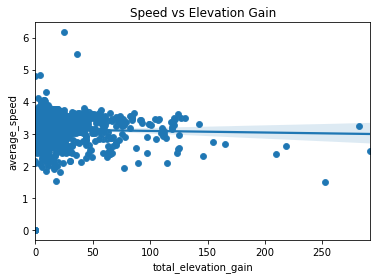

In [15]:
plot_json , plot_json2,run = compare_time_frames(df_strava_combined)



In [16]:
def train_and_display(df, name):
    
    """
    Trains the same df from the time split function on three different models to compare:
    
    Regreesion
    k-NN
    Decision Tree
    
    Saves Plotly figure to JSON for front end output
    
    Args:
        df: passed through from compare_time_frames
        name: mostly for front end, it is from a drop down menu where you can choose which model to see
        
    """
    if name == None:
        name = 'knn'
    X = run.total_elevation_gain.values[:, None]
    X_train, X_test, y_train, y_test = train_test_split(
    X, run.average_speed, random_state=42)

    models = {'Regression': linear_model.LinearRegression,
        'DecisionTree': tree.DecisionTreeRegressor,
        'knn': neighbors.KNeighborsRegressor}
 
    model = models[name]()
    model.fit(X_train, y_train)

    x_range = np.linspace(X.min(), X.max(), 100)
    y_range = model.predict(x_range.reshape(-1, 1))

    fig = go.Figure([
        go.Scatter(x=X_train.squeeze(), y=y_train, 
                name='train', mode='markers'),
        go.Scatter(x=X_test.squeeze(), y=y_test, 
                name='test', mode='markers'),
        go.Scatter(x=x_range, y=y_range, 
                name='prediction')
        ])
    
    fig.show()
    
    # saves fig to JSON string for front end
    plot_json3 = json.dumps(fig, cls = plotly.utils.PlotlyJSONEncoder)
    myText = open(r'graph_3_strava_'+str(name)+'.txt','w')
    myString = plot_json3
    myText.write(myString)
    myText.close()
    

    
   


    return plot_json3

In [17]:
train_and_display(run, name='knn')

'{"data": [{"mode": "markers", "name": "train", "x": [57.0, 39.0, 29.0, 121.0, 46.0, 34.0, 5.0, 32.0, 127.0, 54.0, 23.0, 5.0, 32.0, 21.0, 24.0, 6.0, 123.0, 27.0, 40.0, 52.0, 36.0, 39.0, 19.0, 29.0, 29.0, 30.0, 37.0, 23.0, 12.0, 42.0, 121.0, 21.0, 3.0, 7.0, 21.0, 7.0, 70.0, 44.0, 56.0, 22.0, 44.0, 7.0, 39.0, 10.0, 15.0, 5.0, 7.0, 49.0, 2.0, 99.0, 37.0, 7.0, 25.0, 77.0, 108.0, 130.0, 8.0, 18.0, 26.0, 119.0, 119.0, 124.0, 42.0, 92.0, 125.0, 112.0, 0.0, 44.0, 17.0, 11.0, 165.0, 75.0, 59.0, 27.0, 22.0, 3.0, 29.0, 28.0, 57.0, 33.0, 29.0, 20.0, 66.0, 62.0, 18.0, 24.0, 47.0, 104.0, 31.0, 51.0, 26.0, 23.0, 8.0, 4.0, 37.0, 7.0, 21.0, 39.0, 122.0, 16.0, 3.0, 23.0, 68.0, 28.0, 18.0, 15.0, 10.0, 5.0, 43.0, 24.0, 32.0, 6.0, 12.0, 83.0, 91.0, 12.0, 24.0, 57.0, 6.0, 5.0, 210.0, 70.0, 110.0, 6.0, 6.0, 19.0, 7.0, 23.0, 40.0, 20.0, 45.0, 30.0, 66.0], "y": [3.5589999999999997, 3.425, 3.403, 3.426, 3.458, 3.52, 3.7510000000000003, 3.5010000000000003, 3.505, 3.445, 3.028, 2.521, 3.498, 3.375, 3.366, 3.675, 

In [18]:
train_and_display(run, name='Regression')

'{"data": [{"mode": "markers", "name": "train", "x": [57.0, 39.0, 29.0, 121.0, 46.0, 34.0, 5.0, 32.0, 127.0, 54.0, 23.0, 5.0, 32.0, 21.0, 24.0, 6.0, 123.0, 27.0, 40.0, 52.0, 36.0, 39.0, 19.0, 29.0, 29.0, 30.0, 37.0, 23.0, 12.0, 42.0, 121.0, 21.0, 3.0, 7.0, 21.0, 7.0, 70.0, 44.0, 56.0, 22.0, 44.0, 7.0, 39.0, 10.0, 15.0, 5.0, 7.0, 49.0, 2.0, 99.0, 37.0, 7.0, 25.0, 77.0, 108.0, 130.0, 8.0, 18.0, 26.0, 119.0, 119.0, 124.0, 42.0, 92.0, 125.0, 112.0, 0.0, 44.0, 17.0, 11.0, 165.0, 75.0, 59.0, 27.0, 22.0, 3.0, 29.0, 28.0, 57.0, 33.0, 29.0, 20.0, 66.0, 62.0, 18.0, 24.0, 47.0, 104.0, 31.0, 51.0, 26.0, 23.0, 8.0, 4.0, 37.0, 7.0, 21.0, 39.0, 122.0, 16.0, 3.0, 23.0, 68.0, 28.0, 18.0, 15.0, 10.0, 5.0, 43.0, 24.0, 32.0, 6.0, 12.0, 83.0, 91.0, 12.0, 24.0, 57.0, 6.0, 5.0, 210.0, 70.0, 110.0, 6.0, 6.0, 19.0, 7.0, 23.0, 40.0, 20.0, 45.0, 30.0, 66.0], "y": [3.5589999999999997, 3.425, 3.403, 3.426, 3.458, 3.52, 3.7510000000000003, 3.5010000000000003, 3.505, 3.445, 3.028, 2.521, 3.498, 3.375, 3.366, 3.675, 

In [19]:
train_and_display(run, name='DecisionTree')

'{"data": [{"mode": "markers", "name": "train", "x": [57.0, 39.0, 29.0, 121.0, 46.0, 34.0, 5.0, 32.0, 127.0, 54.0, 23.0, 5.0, 32.0, 21.0, 24.0, 6.0, 123.0, 27.0, 40.0, 52.0, 36.0, 39.0, 19.0, 29.0, 29.0, 30.0, 37.0, 23.0, 12.0, 42.0, 121.0, 21.0, 3.0, 7.0, 21.0, 7.0, 70.0, 44.0, 56.0, 22.0, 44.0, 7.0, 39.0, 10.0, 15.0, 5.0, 7.0, 49.0, 2.0, 99.0, 37.0, 7.0, 25.0, 77.0, 108.0, 130.0, 8.0, 18.0, 26.0, 119.0, 119.0, 124.0, 42.0, 92.0, 125.0, 112.0, 0.0, 44.0, 17.0, 11.0, 165.0, 75.0, 59.0, 27.0, 22.0, 3.0, 29.0, 28.0, 57.0, 33.0, 29.0, 20.0, 66.0, 62.0, 18.0, 24.0, 47.0, 104.0, 31.0, 51.0, 26.0, 23.0, 8.0, 4.0, 37.0, 7.0, 21.0, 39.0, 122.0, 16.0, 3.0, 23.0, 68.0, 28.0, 18.0, 15.0, 10.0, 5.0, 43.0, 24.0, 32.0, 6.0, 12.0, 83.0, 91.0, 12.0, 24.0, 57.0, 6.0, 5.0, 210.0, 70.0, 110.0, 6.0, 6.0, 19.0, 7.0, 23.0, 40.0, 20.0, 45.0, 30.0, 66.0], "y": [3.5589999999999997, 3.425, 3.403, 3.426, 3.458, 3.52, 3.7510000000000003, 3.5010000000000003, 3.505, 3.445, 3.028, 2.521, 3.498, 3.375, 3.366, 3.675, 

In [20]:
def predict_kudos(df):
    """
    This function tries to use Linear Regression to look for features from the Strava API that can best predict 
    the number of Kudos I am likely to recieve on a given run. The R^2 does not look too promising, however, 
    there is some hope as more data is obtained daily/automatically from the Stava API
    """
    
    cols = ['kudos_count', 'total_photo_count', 'type', 'distance', 'moving_time',   
            'average_speed', 'max_speed','total_elevation_gain',
            'activity_id','comment_count','average_heartrate','average_temp'
        ]
    df = df[cols]

    mesh_size = .02
    margin = 0


    X = df[['max_speed', 'distance']]
    y = df['kudos_count']
    

    # Condition the model on sepal width and length, predict the petal width
    model = SVR(C=1.)
    model.fit(X, y)

    # Create a mesh grid on which we will run our model
    x_min, x_max = X.max_speed.min() - margin, X.max_speed.max() + margin
    y_min, y_max = X.distance.min() - margin, X.distance.max() + margin
    xrange = np.arange(x_min, x_max, mesh_size)
    yrange = np.arange(y_min, y_max, mesh_size)
    xx, yy = np.meshgrid(xrange, yrange)

    # Run model
    pred = model.predict(np.c_[xx.ravel(), yy.ravel()])
    pred = pred.reshape(xx.shape)

    # Generate the plot
    fig = px.scatter_3d(df, x='max_speed', y='distance', z='kudos_count')
    fig.update_traces(marker=dict(size=5))
    fig.add_traces(go.Surface(x=xrange, y=yrange, z=pred, name='pred_surface'))
    
    fig.show()
    
    # saves fig as JSON string for front end
    plot_json4 = json.dumps(fig, cls = plotly.utils.PlotlyJSONEncoder)
    myText = open(r'graph_4_strava.txt','w')
    myString = plot_json4
    myText.write(myString)
    myText.close()


    return plot_json4

In [21]:
predict_kudos(df_api)

'{"data": [{"hovertemplate": "max_speed=%{x}<br>distance=%{y}<br>kudos_count=%{z}<extra></extra>", "legendgroup": "", "marker": {"color": "#636efa", "symbol": "circle", "size": 5}, "mode": "markers", "name": "", "scene": "scene", "showlegend": false, "x": [4.9, 5.2, 5.3, 4.5, 2.0, 3.9, 4.4, 5.3, 5.6, 8.7, 6.8, 3.0, 22.9, 4.8, 2.0, 5.9, 2.1, 6.6, 5.9, 5.4, 7.8, 4.7, 3.7, 4.5, 6.1, 4.6, 4.6, 4.9, 4.9, 3.4, 4.4, 6.9, 4.4, 5.6, 4.8, 4.7, 5.2, 5.3, 5.3, 4.6, 4.6, 4.7, 4.8, 6.5, 7.0, 4.8, 7.6, 4.9, 4.5, 4.9, 5.4, 5.0, 3.3, 3.4, 4.6, 3.5, 4.6, 15.4, 4.4, 4.7, 2.8, 2.0, 5.4, 5.3, 5.1, 3.7, 4.2, 3.4, 3.3, 3.6, 5.5, 4.8, 4.8, 4.6, 4.7, 4.8, 3.8, 4.8, 4.0, 4.4, 4.6, 4.8, 3.9, 5.0, 4.0, 2.6, 5.1, 5.4, 4.6, 4.6, 5.0, 4.3, 5.6, 4.9, 2.5, 6.3, 4.8, 3.4, 4.4, 5.1, 4.9, 8.2, 5.3, 4.6, 3.3, 4.7, 4.7, 8.9, 5.0, 9.9, 5.0, 4.7, 3.3, 4.1, 4.8, 5.4, 4.3, 4.5, 4.8, 4.3, 4.9, 5.3, 4.5, 5.3, 3.9, 4.4, 4.2, 4.2, 2.7, 5.0, 4.2, 4.7, 4.9, 4.0, 4.8, 4.1, 5.0, 3.5, 4.5, 4.9, 4.5, 5.0, 2.1, 5.0, 3.3, 4.0, 4.6, 3.8, 5

In [ ]:
def stats_regression(file_path):
        # reads in activities df
    df = file_path#pd.read_csv(file_path)


    #Create new dataframe with only columns I care about
    cols = ['kudos_count', 'total_photo_count', 'type', 'distance', 'moving_time',   
            'average_speed', 'max_speed','total_elevation_gain',
            'activity_id','comment_count','average_heartrate','average_temp'
        ]
    df = df[cols]

    features = ['total_photo_count', 'distance','average_speed']
    #features = ['total_photo_count']
    target = 'kudos_count'
    x = df[features].values.reshape(-1, len(features))
    y = df[target].values
    
    x = sm.add_constant(x)
    
    model = sm.OLS(y, x)
    results = model.fit()
    print(results.summary())
    
    print('coefficient of determination:', results.rsquared)

    print('adjusted coefficient of determination:', results.rsquared_adj)

    print('regression coefficients:', results.params)

    #print('predicted response:', results.fittedvalues, sep='\n')



    #print('predicted response:', results.predict(x), sep='\n')
    
    
stats_regression(df_api)

In [ ]:
stats_regression(df_api)